**Tarea # 3** Aprendizaje Automatico

*   Juan Pablo Fernández Delgado


Para la tarea #3 se va a utilizar el dataset visto e clase del titanic, con ello se va analizar tres métodos vistos en clase, regresión lineal, arboles de decisión y regresión logística, también se va utilizar el método no visto en clase como lo es el k-means como cuarto método y solicitado en la tarea.

In [0]:
# Se importan las librerías
import numpy as np
import pandas as pd
# Librería  para graficar
import matplotlib.pylab as plt
%matplotlib inline
# Librería  método regresión lineal
from sklearn.linear_model import LinearRegression
# Librería método Arboles de decisión
from sklearn.tree import DecisionTreeClassifier
# Librería método regresión logística
from sklearn.linear_model import LogisticRegression
from sklearn import datasets
# Librería método KMeans
from sklearn.cluster import KMeans
from sklearn import preprocessing
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

In [0]:
# Lectura del dataset
data =  pd.read_csv('https://raw.githubusercontent.com/fmezacr/DataScienceTEC/master/Clase2/titanic.csv')

In [141]:
data.head(10)


,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.0,1,0,A/5 21171,7.2500,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.0,1,0,PC 17599,71.2833,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.0,0,0,STON/O2. 3101282,7.9250,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.0,1,0,113803,53.1000,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.0,0,0,373450,8.0500,NaN,S
5,6,0,3,"Moran, Mr. James",male,NaN,0,0,330877,8.4583,NaN,Q
6,7,0,1,"McCarthy, Mr. Timothy J",male,54.0,0,0,17463,51.8625,E46,S
7,8,0,3,"Palsson, Master. Gosta Leonard",male,2.0,3,1,349909,21.0750,NaN,S
8,9,1,3,"Johnson, Mrs. Oscar W (Elisabeth Vilhelmina Berg)",female,27.0,0,2,347742,11.1333,NaN,S
9,10,1,2,"Nasser, Mrs. Nicholas (Adele Achem)",female,14.0,1,0,237736,30.0708,NaN,C


In [0]:
cols_to_use = ['Pclass', 'Sex', 'Age','Fare','Survived']

In [0]:
data = data[cols_to_use]

In [144]:
data.head(10)

,Pclass,Sex,Age,Fare,Survived
0,3,male,22.0,7.2500,0
1,1,female,38.0,71.2833,1
2,3,female,26.0,7.9250,1
3,1,female,35.0,53.1000,1
4,3,male,35.0,8.0500,0
5,3,male,NaN,8.4583,0
6,1,male,54.0,51.8625,0
7,3,male,2.0,21.0750,0
8,3,female,27.0,11.1333,1
9,2,female,14.0,30.0708,1


In [145]:
data.isnull().values.any()

True

In [0]:
data = data.dropna()

In [147]:
data.isnull().values.any()

False

In [0]:
data['Sex'] = data['Sex'].replace({'male' : 0, 'female' : 1})

In [149]:
data.head(10)

,Pclass,Sex,Age,Fare,Survived
0,3,0,22.0,7.2500,0
1,1,1,38.0,71.2833,1
2,3,1,26.0,7.9250,1
3,1,1,35.0,53.1000,1
4,3,0,35.0,8.0500,0
6,1,0,54.0,51.8625,0
7,3,0,2.0,21.0750,0
8,3,1,27.0,11.1333,1
9,2,1,14.0,30.0708,1
10,3,1,4.0,16.7000,1


In [0]:
from sklearn.model_selection import train_test_split

In [0]:
features = data[['Sex','Age','Fare']]
labels = data['Survived']

In [0]:
# Preparación de datos, parametrizando un 20% para test y un 80% para training
X_train,X_test, y_train, y_test = train_test_split(features, labels, test_size=0.20, random_state = 13) 

In [153]:
data.shape


(714, 5)

In [154]:
X_train.shape

(571, 3)

In [155]:
y_test.shape

(143,)

**Método de Arboles de decisión**


In [0]:
# Se crea el método de Árbol de decisión
dtc = DecisionTreeClassifier()

# Entrenamiento del método
dtc = dtc.fit(X_train,y_train)

# Predicción de la respuesta
predTree = dtc.predict(X_train)

In [157]:
# Datos de la predicción X
predTree

array([0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0,
       1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1,
       1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0,
       0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0,
       0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1,
       0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1,
       0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0,
       1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1,
       1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1,
       0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0,
       1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1,

In [158]:
# Se mustra que tan correcta es la prediccion
print("Accuracy:",accuracy_score(y_train, predTree))

Accuracy: 0.9859894921190894


In [159]:
#Reporte de clasificacion.
print(classification_report(y_train, predTree))

              precision    recall  f1-score   support

           0       0.98      1.00      0.99       338
           1       1.00      0.97      0.98       233

    accuracy                           0.99       571
   macro avg       0.99      0.98      0.99       571
weighted avg       0.99      0.99      0.99       571



In [160]:
# Se imprime todo el árbol de decisión con todas sus hojas
from sklearn.tree import export_graphviz
# Se exporta como un archivo
export_graphviz(dtc, out_file='tree.dot', 
                feature_names = features.columns,
                class_names = ['Not survived','Survived'],
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

from IPython.display import Image
Image(filename = 'tree.png')


In [161]:
# Se reduce la profundidad del árbol a 3 ramas
dtc = DecisionTreeClassifier(criterion="entropy", max_depth=3)

# Entrenamiento del método
dtc = dtc.fit(X_train,y_train)

# Predicción de la respuesta
predTree = dtc.predict(X_train)

# Se mustra que tan correcta es la prediccion
print("Accuracy:",accuracy_score(y_train, predTree))

Accuracy: 0.7933450087565674


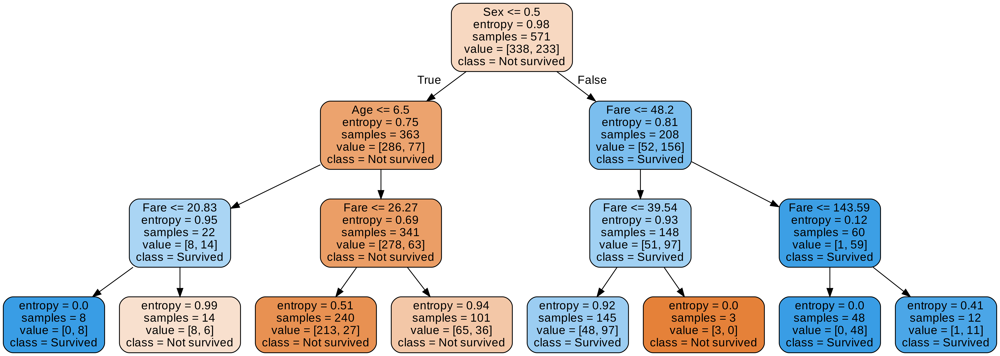

In [162]:
# Se vuelve a imprime el árbol esta vez va a mostrar una entropía de 3 niveles
from sklearn.tree import export_graphviz
# Se exporta como un archivo
export_graphviz(dtc, out_file='tree.dot', 
                feature_names = features.columns,
                class_names = ['Not survived','Survived'],
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

from IPython.display import Image
Image(filename = 'tree.png')

**Método de Regresión Lineal**

In [163]:
# Modelo de regrecion lineal
model = LinearRegression()
# usa el entrenamiento
model.fit(X_train, y_train)
# revisa el score
model.score(X_train, y_train)

0.3122333306694196

In [164]:
model.coef_ # Obtiene el coeficiente, beta

array([ 0.50480833, -0.00129001,  0.00179294])

In [165]:
model.intercept_ # Obtiene la intercepción, c

0.20067955563466439

In [166]:
# Predicción 
model.predict(X_train) 

array([0.21297114, 0.68615673, 0.1669433 , 0.2510225 , 0.69005706,
       0.75812292, 0.70814537, 0.25392238, 0.68235583, 0.1799384 ,
       0.71469417, 0.67164223, 0.17497813, 0.2763303 , 0.1927807 ,
       0.16323593, 0.72438324, 0.19208857, 0.24471609, 0.65981335,
       0.173556  , 0.68744674, 0.71598418, 0.18983526, 0.17853674,
       0.17613602, 0.69024479, 0.18415254, 0.18236947, 0.19429097,
       0.23953999, 0.70443944, 0.18767151, 0.72702598, 0.19143683,
       0.84427763, 0.1777025 , 0.19490944, 0.16473553, 0.23322655,
       1.14736199, 0.17329459, 0.19440506, 0.20155055, 0.23199222,
       0.19152413, 0.6749474 , 0.18129605, 0.15493817, 0.69246734,
       1.05924713, 0.75382216, 0.68876705, 0.1875668 , 0.71989826,
       0.69229301, 1.07410689, 0.34228688, 0.37271101, 0.67461578,
       0.18627679, 0.74134302, 0.19397955, 0.73904943, 0.7075835 ,
       0.20619967, 0.61351032, 0.17720944, 0.69204838, 0.18525338,
       0.19023182, 0.69039522, 0.71008722, 0.19227396, 0.21705

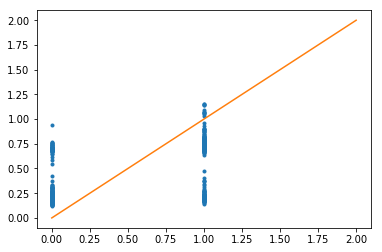

In [167]:
# Grafico de la prediccion y la info actual
predLR = model.predict(X_train) 
plt.plot(y_train, predLR, '.')

# Linea grafica
x = np.linspace(0, 2, 2)
y = x
plt.plot(x, y)
plt.show()

**Método Regresión Logística**

In [0]:
# Método de regresión logística
logreg = LogisticRegression(C=1e5, solver='lbfgs', multi_class='multinomial')

In [169]:
# Instancia de entrenamiento
logreg.fit(X_train, y_train)

LogisticRegression(C=100000.0, class_weight=None, dual=False,
                   fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                   max_iter=100, multi_class='multinomial', n_jobs=None,
                   penalty='l2', random_state=None, solver='lbfgs', tol=0.0001,
                   verbose=0, warm_start=False)

In [0]:
# Prediccion del modelo
predReg=logreg.predict(X_train)

In [171]:
predReg

array([0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1,
       1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0,
       1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1,
       0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0,
       0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1,
       0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0,
       1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0,
       1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0,
       1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0,
       0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0,
       0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0,

In [172]:
# Se mustra que tan correcta es la prediccion
accuracy_score(y_train, predReg)

0.7705779334500875

In [173]:
# Utilizamos la matrix de confusión y validamos la precisión
cnf_matrix = confusion_matrix(y_train, predReg)
cnf_matrix

array([[281,  57],
       [ 74, 159]])

In [174]:
# Reporte de clasificación.
print(classification_report(y_train, predReg))

              precision    recall  f1-score   support

           0       0.79      0.83      0.81       338
           1       0.74      0.68      0.71       233

    accuracy                           0.77       571
   macro avg       0.76      0.76      0.76       571
weighted avg       0.77      0.77      0.77       571



**Método K-means**


In [175]:
# Convertimos los valores numpy para el procesamiento.
X1 = np.array(X_train)
y1 = np.array(y_train)

kms = KMeans(n_clusters=2)
kms.fit(X1)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=2, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [176]:
# Método para la predicción
correct = 0
for i in range(len(X1)):
    predict_me = np.array(X1[i].astype(float))
    predict_me = predict_me.reshape(-1, len(predict_me))
    prediction = kms.predict(predict_me)
    if prediction[0] == y1[i]:
        correct += 1

print(correct/len(X1))

0.6234676007005254


In [177]:
#Preprocesamiento Kmeans
X1 = np.array(X_train)
X1 = preprocessing.scale(X1)
y1 = np.array(y_train)

kms = KMeans(n_clusters=2)
kms.fit(X1)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=2, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [178]:
# Método para la predicción
correct = 0
for i in range(len(X1)):
    predict_me = np.array(X1[i].astype(float))
    predict_me = predict_me.reshape(-1, len(predict_me))
    prediction = kms.predict(predict_me)
    if prediction[0] == y1[i]:
        correct += 1

print(correct/len(X1))

0.22591943957968477


**Conclusión**

Para concluir utilizamos varios métodos para ver el comportamiento de los datos, los datos con los metodos vistos en clase (regresión lineal, regresión logística y  árboles de decisión) estaban generalizados lo cual se en los reportes de la tarea, pero el del metodo kmean presento problemas de overfitting.
Para la investigación utilizamos dos métodos de regresión(Regresión lineal y Regresión logística), y también dos de clasificación como lo son el de árboles de decisión y el kmean.

